In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# imports
import sys
sys.path.append("..")
#import os
#import shutil

from utils.model import Net_mask
import torch
#from torch.distributions.multivariate_normal import MultivariateNormal

import matplotlib.pyplot as plt
import numpy as np

In [4]:
num = 0
e = 5

In [5]:
prior_weights = torch.load(f'../data/@/1.0e+0{e}/rml_noise/{num}/noise_parameter.pt')[0]
prior_weights *= -1

In [6]:
model = Net_mask()
model.load_state_dict(torch.load(f'../data/@/weight_init/rml_e{e}_{num}.pth'))
init_weights = torch.cat([param.view(-1) for param in model.parameters()])
#model.load_state_dict(torch.load(f'../saved_models/testing/rml/long/e{e}/{num}/model_weights.pth'))
model.load_state_dict(torch.load(f'../saved_models/testing/rml/long/e4/{num}/model_weights.pth'))
posterior_weights = torch.cat([param.view(-1) for param in model.parameters()])
n_param = len(prior_weights)
print(n_param)

13210


In [7]:
print(init_weights)
print(prior_weights)
print(posterior_weights)

tensor([ 0.2141,  0.1882,  0.1617,  ...,  0.0353, -0.0058,  0.0218],
       grad_fn=<CatBackward0>)
tensor([ 0.0716, -0.2811,  0.1117,  ...,  0.0373,  0.0394,  0.1918])
tensor([0.0238, 0.0733, 0.1377,  ..., 0.3689, 0.0090, 0.3881],
       grad_fn=<CatBackward0>)


In [8]:
print(torch.sum((init_weights + prior_weights)**2))

tensor(1281.4557, grad_fn=<SumBackward0>)


In [9]:
x_min = -1
x_max = 1
lim1 = 0.1
lim2 = 0.1
#lim2 = lim1
x = np.linspace(x_min, x_max, 1000)
x2_p1 = np.linspace(x_min, lim2-lim1, 1000)
x2_p2 = np.linspace(lim2+lim1, x_max, 1000)
x2_p3 = np.linspace(x_min, -lim1 - lim2, 1000)
x2_p4 = np.linspace(-lim2 + lim1, x_max, 1000)
y2_p1 = x2_p1*0+lim2
y2_p2 = x2_p2*0+lim2
y2_p3 = x2_p3*0 -lim2
y2_p4 = x2_p4*0 -lim2
a1_up = lim1 + x
a1_down = -lim1 + x
a2_up = lim2 + 0*x
a2_down = -lim2 + 0*x

p_x = [lim2 - lim1, lim2 + lim1, -lim2 - lim1, -lim2 + lim1]
p_y = [lim2, lim2, -lim2, -lim2]

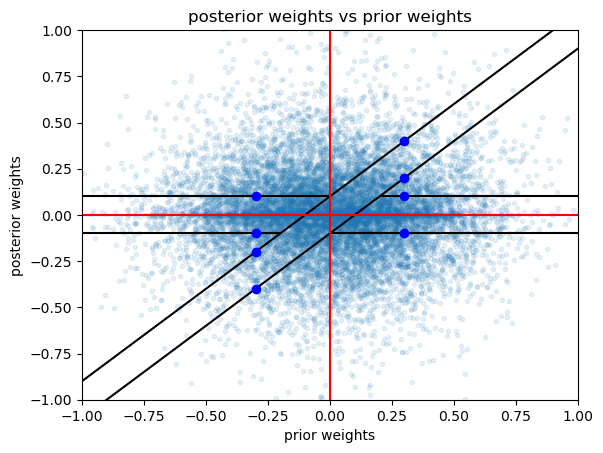

In [10]:
plt.plot(prior_weights.detach(), posterior_weights.detach(), '.', alpha=0.1)
plt.plot(x, a1_up, 'k')
plt.plot(x, a1_down, 'k')
plt.plot(x2_p1, y2_p1, 'k')
plt.plot(x2_p2, y2_p2, 'k')
plt.plot(x2_p3, y2_p3, 'k')
plt.plot(x2_p4, y2_p4, 'k')
#plt.plot(x, a2_up, 'r')
#plt.plot(x, a2_down, 'r')
#plt.plot(p_x, p_y, 'bo')
#plt.plot([-1, 1], [-1, 1], alpha=0.1)

x_point = 0.3
a1_min = x_point - lim1
a1_max = x_point + lim1
a2_min = -lim2
a2_max = lim2
x_point_neg = -0.3
a1_min_neg = x_point_neg - lim1
a1_max_neg = x_point_neg + lim1
a2_min_neg = -lim2
a2_max_neg = lim2
plt.plot([x_point, x_point, x_point, x_point], [a1_min, a1_max, a2_min, a2_max], 'bo')
plt.plot([x_point_neg, x_point_neg, x_point_neg, x_point_neg], [a1_min_neg, a1_max_neg, a2_min_neg, a2_max_neg], 'bo')

plt.plot(x, x*0, 'r')
plt.plot(0*x, x, 'r')
plt.axis([x_min, x_max, x_min, x_max])
plt.xlabel('prior weights')
plt.ylabel('posterior weights')
plt.title('posterior weights vs prior weights')
plt.savefig(f'../figures/plot_weights_posterior_vs_prior/plot_weights.png')

In [11]:
#prior_weights = prior_weights 
a1_min_tens = prior_weights - lim1
a1_max_tens = prior_weights + lim1
a2_min_tens = prior_weights*0 - lim2
a2_max_tens = prior_weights*0 + lim2

In [12]:
#plt.plot(prior_weights, a1_min_tens, '.', alpha=0.1)
#plt.plot(prior_weights, a1_max_tens, '.', alpha=0.1)
#plt.plot(prior_weights, a2_min_tens, '.', alpha=0.1)
#plt.plot(prior_weights, a2_max_tens, '.', alpha=0.1)

In [13]:
import matplotlib.lines as mlines

#eight = mlines.Line2D([], [], color='blue', marker='s', ls='', label='8')
#nine = mlines.Line2D([], [], color='blue', marker='D', ls='', label='9')
lw = 2
#all_ = mlines.Line2D([], [], color='blue', ls='-', lw=lw, label='all')
#l1 = mlines.Line2D([], [], color='blue', marker='o', lw=lw, label='diagonal')
#l2 = mlines.Line2D([], [], color='orange', marker='o', lw=lw, label='horizontal')
#l3 = mlines.Line2D([], [], color='green', marker='o', lw=lw, label='top')
#l4 = mlines.Line2D([], [], color='red', marker='o', lw=lw, label='bottom')
#l1 = mlines.Line2D([], [], '', marker='o', color='royalblue', label='diagonal')
#l1 = mlines.Line2D([], [], color='royalblue', linestyle='', marker='o', label='diagonal')
l1 = mlines.Line2D([], [], color='C0', linestyle='', marker='o', label='diagonal')
l2 = mlines.Line2D([], [], color='orange', linestyle='', marker='o', label='horizontal')
l3 = mlines.Line2D([], [], color='green', linestyle='', marker='o', label='top')
l4 = mlines.Line2D([], [], color='red', linestyle='', marker='o', label='bottom')
l5 = mlines.Line2D([], [], color='grey', linestyle='', marker='o', label='rest')
# etc etc
#plt.legend(handles=[all_, l1, l2, l3])

Text(0.5, 1.0, 'Four areas of interest')

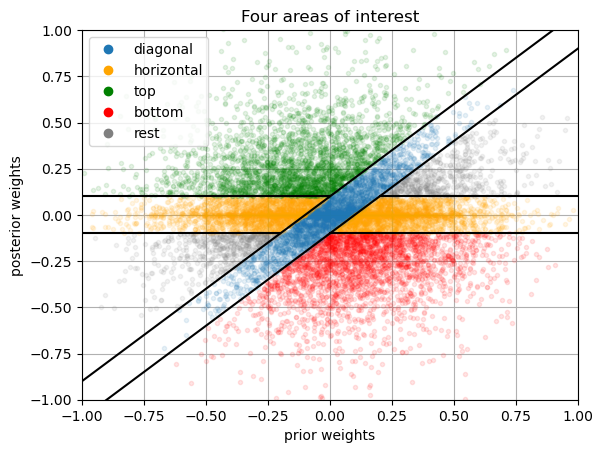

In [14]:
a1_mask = torch.logical_and(posterior_weights >= a1_min_tens, posterior_weights <= a1_max_tens)
a2_mask = torch.logical_and(torch.logical_not(a1_mask), torch.logical_and(posterior_weights >= a2_min_tens, posterior_weights <= a2_max_tens))
a3_mask = torch.logical_and(posterior_weights > a1_max_tens, posterior_weights > a2_max_tens)
a4_mask = torch.logical_and(posterior_weights < a1_min_tens, posterior_weights < a2_min_tens)
a5_mask = torch.logical_and(posterior_weights < a1_min_tens, posterior_weights > a2_max_tens)
a6_mask = torch.logical_and(posterior_weights > a1_max_tens, posterior_weights < a2_min_tens)
#a6_mask
a1_prior = torch.masked_select(prior_weights, a1_mask)
a2_prior = torch.masked_select(prior_weights, a2_mask)
a3_prior = torch.masked_select(prior_weights, a3_mask)
a4_prior = torch.masked_select(prior_weights, a4_mask)
a5_prior = torch.masked_select(prior_weights, a5_mask)
a6_prior = torch.masked_select(prior_weights, a6_mask)
a1_posterior = torch.masked_select(posterior_weights, a1_mask)
a2_posterior = torch.masked_select(posterior_weights, a2_mask)
a3_posterior = torch.masked_select(posterior_weights, a3_mask)
a4_posterior = torch.masked_select(posterior_weights, a4_mask)
a5_posterior = torch.masked_select(posterior_weights, a5_mask)
a6_posterior = torch.masked_select(posterior_weights, a6_mask)
#plt.plot(a1_prior.detach(), a1_posterior.detach(), '.', color='royalblue', alpha=0.1)
plt.plot(a1_prior.detach(), a1_posterior.detach(), '.', color='C0', alpha=0.1)
plt.plot(a2_prior.detach(), a2_posterior.detach(), '.', color='orange', alpha=0.1)
plt.plot(a3_prior.detach(), a3_posterior.detach(), '.', color='green', alpha=0.1)
plt.plot(a4_prior.detach(), a4_posterior.detach(), '.', color='red', alpha=0.1)
plt.plot(a5_prior.detach(), a5_posterior.detach(), '.', color='grey', alpha=0.1)
plt.plot(a6_prior.detach(), a6_posterior.detach(), '.', color='grey', alpha=0.1)

#plt.legend(['top', 'bottom', 'horizontal', 'diagonal'])
plt.legend(handles=[l1, l2, l3, l4, l5], loc=2)



plt.plot(x, a1_up, 'k')
plt.plot(x, a1_down, 'k')
plt.plot(x2_p1, y2_p1, 'k')
plt.plot(x2_p2, y2_p2, 'k')
plt.plot(x2_p3, y2_p3, 'k')
plt.plot(x2_p4, y2_p4, 'k')
#plt.plot(x, x*0, 'k')
#plt.plot(0*x, x, 'k')
plt.grid()

plt.axis([x_min, x_max, x_min, x_max])
#plt.axis([-3, 3, -3, 3])

plt.xlabel('prior weights')
plt.ylabel('posterior weights')
plt.title('Four areas of interest')
#import itertools
#leg1 = plt.legend(['test'], loc=1)
#leg2 = plt.legend(['test2'], loc=4)
#plt.gca().add_artist(leg1)
#plt.gca().add_artist(leg2)
#plt.savefig(f'../figures/plot_weights_posterior_vs_prior/4_areas_colored_e4.png')
#plt.savefig(f'../figures/plot_weights_posterior_vs_prior/4_areas_colored_e5.png')

In [15]:
a1_mask = torch.logical_and(posterior_weights >= a1_min_tens, posterior_weights <= a1_max_tens)
print(len(a1_mask[a1_mask]))
print(torch.sum(a1_mask*1))

2772
tensor(2772)


In [16]:
x_min = -1
x_max = 1
lim1 = 0.1
lim2 = 0.1

f_list = list(range(100)) 
f_len = len(f_list)
areas_num = torch.zeros(2, 5, f_len)
for idx, e in enumerate([4, 5]):
    for idx_num, num in enumerate(f_list):
        prior_weights = torch.load(f'../data/@/1.0e+0{e}/rml_noise/{num}/noise_parameter.pt')[0]
        prior_weights *= -1
        model = Net_mask()
        model.load_state_dict(torch.load(f'../saved_models/testing/rml/long/e{e}/{num}/model_weights.pth'))
        posterior_weights = torch.cat([param.view(-1) for param in model.parameters()])

        a1_min_tens = prior_weights - lim1
        a1_max_tens = prior_weights + lim1
        a2_min_tens = prior_weights*0 - lim2
        a2_max_tens = prior_weights*0 + lim2
        
        a1_mask = torch.logical_and(posterior_weights >= a1_min_tens, posterior_weights <= a1_max_tens)
        a2_mask = torch.logical_and(torch.logical_not(a1_mask), torch.logical_and(posterior_weights >= a2_min_tens, posterior_weights <= a2_max_tens))
        a3_mask = torch.logical_and(posterior_weights > a1_max_tens, posterior_weights > a2_max_tens)
        a4_mask = torch.logical_and(posterior_weights < a1_min_tens, posterior_weights < a2_min_tens)
        a5_mask = torch.logical_and(posterior_weights < a1_min_tens, posterior_weights > a2_max_tens)
        a6_mask = torch.logical_and(posterior_weights > a1_max_tens, posterior_weights < a2_min_tens)

        areas_num[idx, 0, idx_num] = torch.sum(a1_mask*1)
        areas_num[idx, 1, idx_num] = torch.sum(a2_mask*1)
        areas_num[idx, 2, idx_num] = torch.sum(a3_mask*1)
        areas_num[idx, 3, idx_num] = torch.sum(a4_mask*1)
        areas_num[idx, 4, idx_num] = torch.sum(a5_mask*1) + torch.sum(a6_mask*1)

In [17]:
title = f'{"Data":6} | {"Area":11} | {"min":7} | {"P10":7} | {"P50":7} | {"P90":7} | {"max":7} |\n'
s = title
#s += f'{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|\n'
area_ = ['diagonal', 'horizontile', 'top', 'bottom', 'rest']
lin = '-'*72 + '\n'
s += lin
e = 0
for a in range(5):
    s += f'{"10^4":6} | {area_[a]:11} | {torch.quantile(areas_num[e,a], 0)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.1)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.5)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.9)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 1)/n_param*100:7.2f} |\n'
s += lin
e = 1
for a in range(5):
    s += f'{"10^5":6} | {area_[a]:11} | {torch.quantile(areas_num[e,a], 0)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.1)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.5)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.9)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 1)/n_param*100:7.2f} |\n'
s += lin 

#print(torch.quantile(areas_num[0,0], 0))
#print(torch.quantile(areas_num[0,0], 0.1))
#print(torch.quantile(areas_num[0,0], 0.5))
#print(torch.quantile(areas_num[0,0], 0.9))
#print(torch.quantile(areas_num[0,0], 1))
print(s)
with open('../figures/plot_weights_posterior_vs_prior/table.txt', 'w') as outfile:
    outfile.write('\n\n' + s[:-1])



Data   | Area        | min     | P10     | P50     | P90     | max     |
------------------------------------------------------------------------
10^4   | diagonal    |   50.66 |   53.08 |   55.42 |   57.48 |   59.61 |
10^4   | horizontile |   20.30 |   21.85 |   22.94 |   24.08 |   25.53 |
10^4   | top         |    5.40 |    5.82 |    6.41 |    6.91 |    7.36 |
10^4   | bottom      |    5.23 |    5.64 |    6.12 |    6.62 |    7.34 |
10^4   | rest        |    7.66 |    8.26 |    9.24 |   10.02 |   10.50 |
------------------------------------------------------------------------
10^5   | diagonal    |   26.28 |   26.80 |   27.36 |   27.91 |   28.57 |
10^5   | horizontile |   44.77 |   45.50 |   46.70 |   47.64 |   48.38 |
10^5   | top         |    6.81 |    7.32 |    7.68 |    8.00 |    8.42 |
10^5   | bottom      |    6.15 |    6.54 |    6.93 |    7.32 |    7.65 |
10^5   | rest        |   10.26 |   10.74 |   11.44 |   12.01 |   12.58 |
---------------------------------------------------

In [18]:

x_min = -1
x_max = 1
lim1 = 0.1
lim2 = 0.1

f_list = list(range(100)) 
f_len = len(f_list)
areas_num = torch.zeros(2, 5, f_len)
for idx, e in enumerate([4, 5]):
    for idx_num, num in enumerate(f_list):
        prior_weights = torch.load(f'../data/@/1.0e+0{e}/rml_noise/{num}/noise_parameter.pt')[0]
        prior_weights *= -1
        model = Net_mask()
        model.load_state_dict(torch.load(f'../saved_models/testing/rml/long/e{e}/{num}/model_weights.pth'))
        posterior_weights = torch.cat([param.view(-1) for param in model.parameters()])

        a1_min_tens = prior_weights - lim1
        a1_max_tens = prior_weights + lim1
        a2_min_tens = prior_weights*0 - lim2
        a2_max_tens = prior_weights*0 + lim2
        
        a1_mask = torch.logical_and(posterior_weights >= a1_min_tens, posterior_weights <= a1_max_tens)
        a2_mask = torch.logical_and(torch.logical_not(a1_mask), torch.logical_and(posterior_weights >= a2_min_tens, posterior_weights <= a2_max_tens))
        a3_mask = torch.logical_and(posterior_weights > a1_max_tens, posterior_weights > a2_max_tens)
        a4_mask = torch.logical_and(posterior_weights < a1_min_tens, posterior_weights < a2_min_tens)
        a5_mask = torch.logical_and(posterior_weights < a1_min_tens, posterior_weights > a2_max_tens)
        a6_mask = torch.logical_and(posterior_weights > a1_max_tens, posterior_weights < a2_min_tens)

        areas_num[idx, 0, idx_num] = torch.sum(a1_mask*1)
        areas_num[idx, 1, idx_num] = torch.sum(a2_mask*1)
        areas_num[idx, 2, idx_num] = torch.sum(a3_mask*1)
        areas_num[idx, 3, idx_num] = torch.sum(a4_mask*1)
        areas_num[idx, 4, idx_num] = torch.sum(a5_mask*1) + torch.sum(a6_mask*1)

In [19]:

title = f'{"Data":6} | {"Area":11} | {"min":7} | {"P10":7} | {"P50":7} | {"P90":7} | {"max":7} |\n'
s = title
#s += f'{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|{"-":10}|\n'
area_ = ['diagonal', 'horizontile', 'top', 'bottom', 'rest']
lin = '-'*72 + '\n'
s += lin
e = 0
for a in range(5):
    s += f'{"10^4":6} | {area_[a]:11} | {torch.quantile(areas_num[e,a], 0)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.1)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.5)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.9)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 1)/n_param*100:7.2f} |\n'
s += lin
e = 1
for a in range(5):
    s += f'{"10^5":6} | {area_[a]:11} | {torch.quantile(areas_num[e,a], 0)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.1)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.5)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 0.9)/n_param*100:7.2f} | {torch.quantile(areas_num[e,a], 1)/n_param*100:7.2f} |\n'
s += lin 

#print(torch.quantile(areas_num[0,0], 0))
#print(torch.quantile(areas_num[0,0], 0.1))
#print(torch.quantile(areas_num[0,0], 0.5))
#print(torch.quantile(areas_num[0,0], 0.9))
#print(torch.quantile(areas_num[0,0], 1))
print(s)
#with open('../figures/plot_weights_posterior_vs_prior/table.txt', 'w') as outfile:
#    outfile.write('\n\n' + s[:-1])



Data   | Area        | min     | P10     | P50     | P90     | max     |
------------------------------------------------------------------------
10^4   | diagonal    |   50.66 |   53.08 |   55.42 |   57.48 |   59.61 |
10^4   | horizontile |   20.30 |   21.85 |   22.94 |   24.08 |   25.53 |
10^4   | top         |    5.40 |    5.82 |    6.41 |    6.91 |    7.36 |
10^4   | bottom      |    5.23 |    5.64 |    6.12 |    6.62 |    7.34 |
10^4   | rest        |    7.66 |    8.26 |    9.24 |   10.02 |   10.50 |
------------------------------------------------------------------------
10^5   | diagonal    |   26.28 |   26.80 |   27.36 |   27.91 |   28.57 |
10^5   | horizontile |   44.77 |   45.50 |   46.70 |   47.64 |   48.38 |
10^5   | top         |    6.81 |    7.32 |    7.68 |    8.00 |    8.42 |
10^5   | bottom      |    6.15 |    6.54 |    6.93 |    7.32 |    7.65 |
10^5   | rest        |   10.26 |   10.74 |   11.44 |   12.01 |   12.58 |
---------------------------------------------------

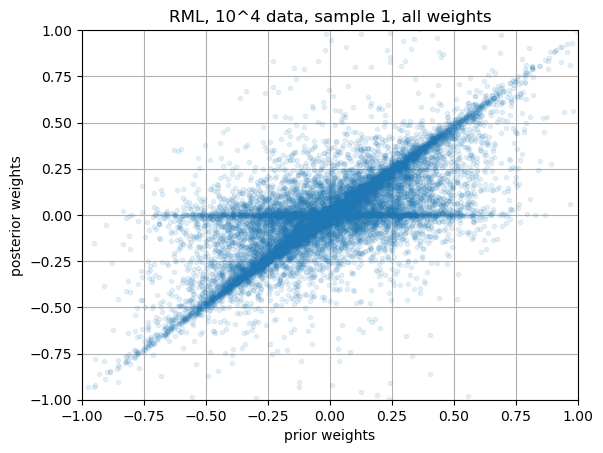

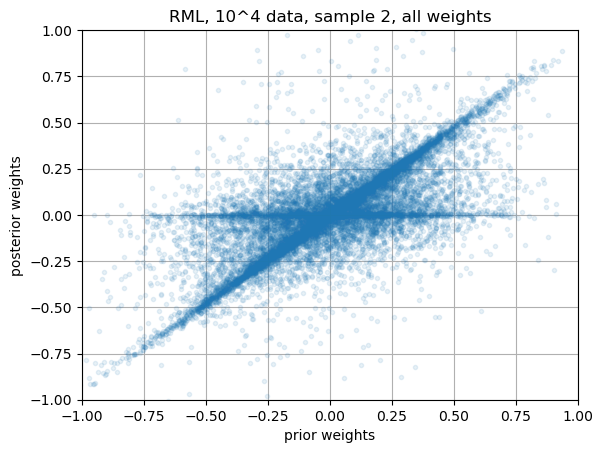

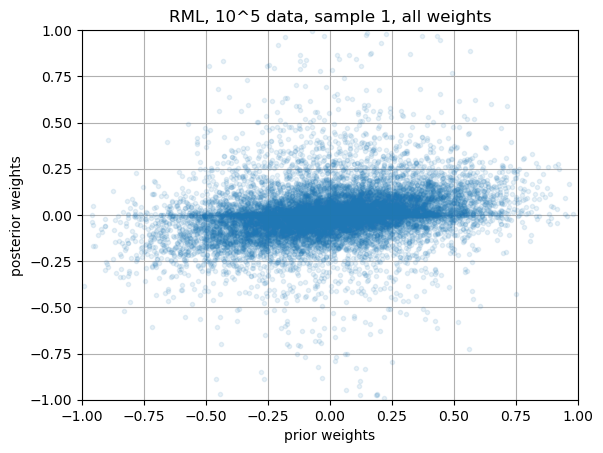

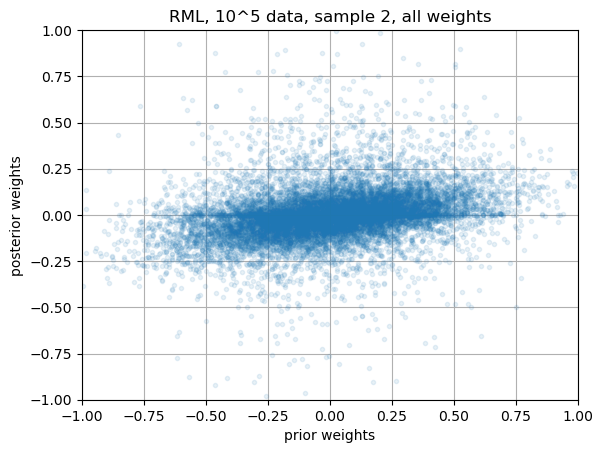

In [23]:
#position_start = [0, 2100, 12200]
#position_end = [2000, 12100, 13200]
#col = ['seagreen', 'dodgerblue', 'darkorange']
#alphas = [0.2, 0.2, 0.2]
#e = 4
e_list = [4, 5]
num_list = [0, 1]
#num = 1
for e_ in e_list:
    for num_ in num_list:
        prior_weights = torch.load(f'../data/@/1.0e+0{e_}/rml_noise/{num_}/noise_parameter.pt')[0]
        prior_weights *= -1
        model = Net_mask()
        model.load_state_dict(torch.load(f'../saved_models/testing/rml/long/e{e_}/{num_}/model_weights.pth'))
        posterior_weights = torch.cat([param.view(-1) for param in model.parameters()])

        plt.figure()
        plt.plot(prior_weights.detach(), posterior_weights.detach(), '.', alpha=0.1)
        x_min = -1
        x_max = 1
        plt.axis([x_min, x_max, x_min, x_max])
        plt.title(f'RML, 10^{e_} data, sample {num_+1}, all weights')
        plt.xlabel('prior weights')
        plt.ylabel('posterior weights')
        plt.grid()
        plt.savefig(f'../figures/plot_weights_posterior_vs_prior/RML_e{e_}_{num_}_layer_all.png')

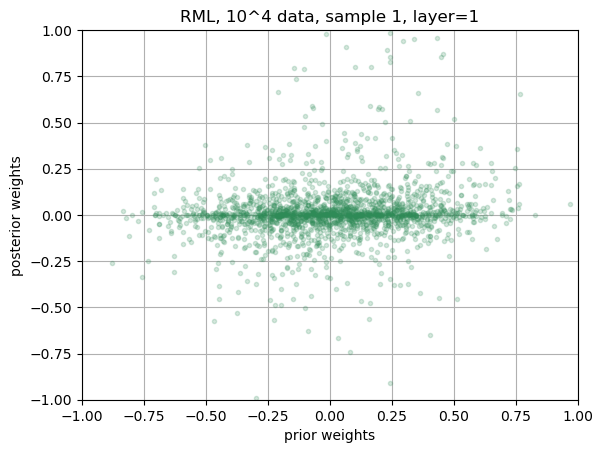

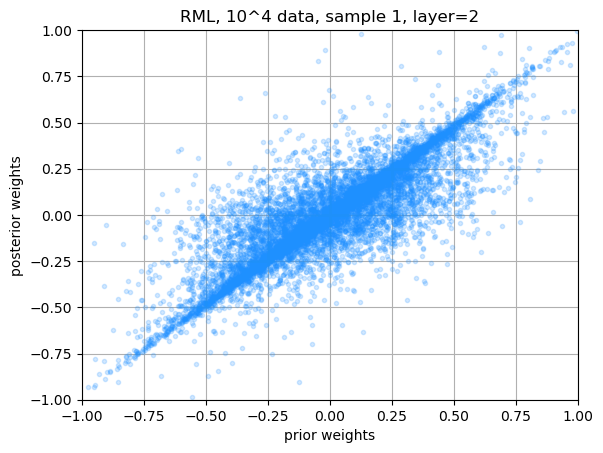

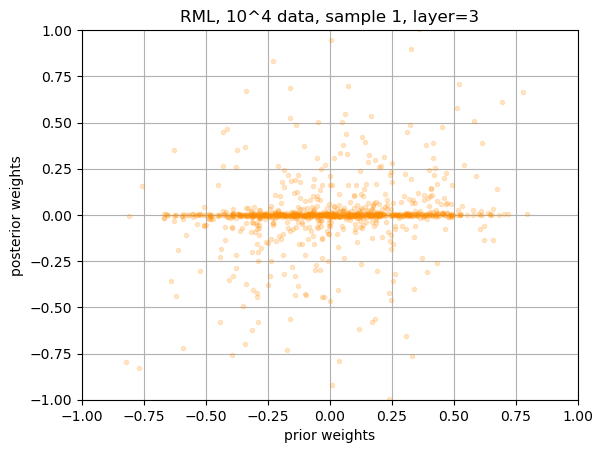

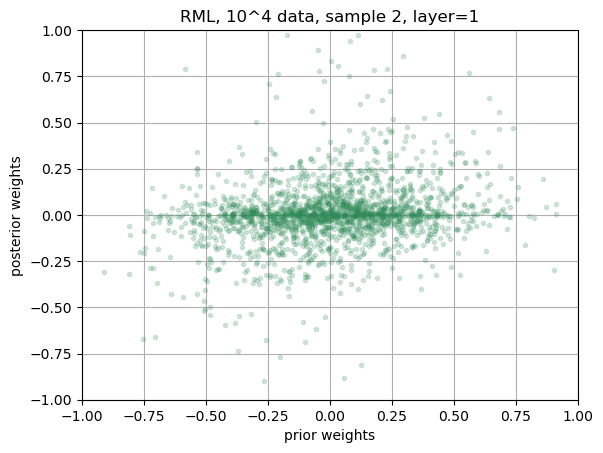

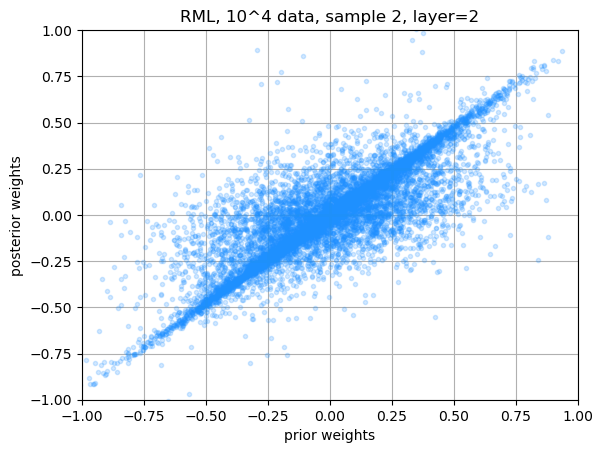

...

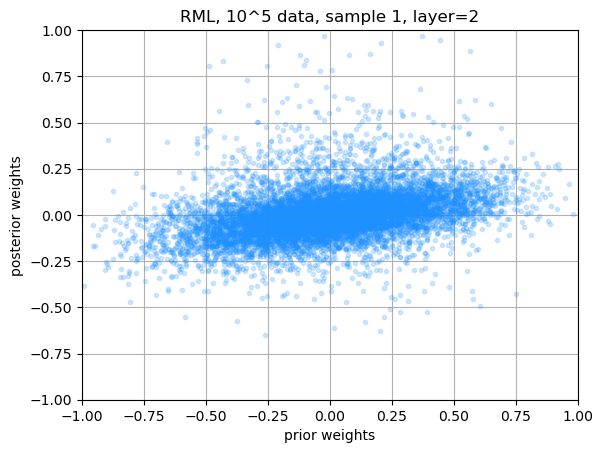

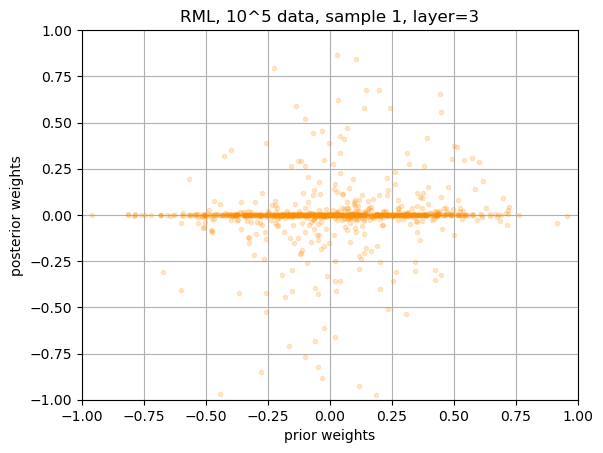

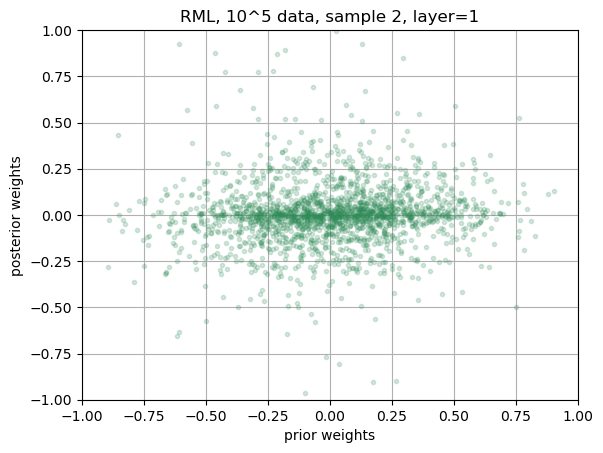

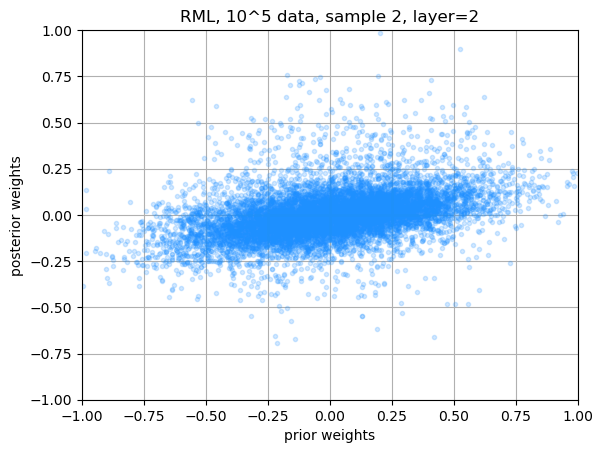

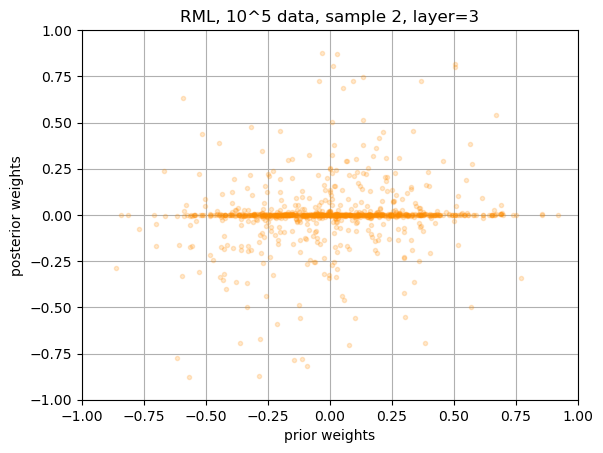

In [22]:
position_start = [0, 2100, 12200]
position_end = [2000, 12100, 13200]
col = ['seagreen', 'dodgerblue', 'darkorange']
alphas = [0.2, 0.2, 0.2]
e = 4
e_list = [4, 5]
num_list = [0, 1]
num = 1
for e_ in e_list:
    for num_ in num_list:
        for layer in range(3):
            prior_weights = torch.load(f'../data/@/1.0e+0{e_}/rml_noise/{num_}/noise_parameter.pt')[0]
            prior_weights *= -1
            model = Net_mask()
            model.load_state_dict(torch.load(f'../saved_models/testing/rml/long/e{e_}/{num_}/model_weights.pth'))
            posterior_weights = torch.cat([param.view(-1) for param in model.parameters()])
            prior_weights = prior_weights[position_start[layer]:position_end[layer]]
            posterior_weights = posterior_weights[position_start[layer]:position_end[layer]]

            plt.figure()
            plt.plot(prior_weights.detach(), posterior_weights.detach(), '.', alpha=alphas[layer], color=col[layer])
            x_min = -1
            x_max = 1
            plt.axis([x_min, x_max, x_min, x_max])
            #plt.title(f'RML-e{e_}-{num_}, layer={layer+1}')
            plt.title(f'RML, 10^{e_} data, sample {num_+1}, layer={layer+1}')
            plt.xlabel('prior weights')
            plt.ylabel('posterior weights')
            plt.grid()
            plt.savefig(f'../figures/plot_weights_posterior_vs_prior/RML_e{e_}_{num_}_layer_{layer+1}.png')